In [ ]:
#algorytmy plus krawedzie
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import cv2

In [ ]:
X=np.linspace(0,10-1,34)
print(X)
for i in range(0,34):
    print(X[i])

X = np.round(X).astype(int)
print(X)

In [ ]:
#NN
def nn_scaling(img, multiplier):
    if multiplier > 5:
        multiplier = multiplier/100

    img_y, img_x, img_c = img.shape


    new_y = int(np.ceil(img_y * multiplier))
    new_x = int(np.ceil(img_x * multiplier))
    img_scaled = np.zeros((new_y, new_x, img_c), dtype=img.dtype)

    # tak jak u kramarczyka w sumie
    y_indices = np.linspace(0, img_y - 1, new_y).astype(int)
    x_indices = np.linspace(0, img_x - 1, new_x).astype(int)

    # None - broadcasting do odpowiedniego wymiaru - działa!
    img_scaled[:, :, :] = img[y_indices[:, None], x_indices[None, :], :]

    return img_scaled

In [ ]:
#Bilinear Interpolation
def bi_scaling(img, multiplier):
    if multiplier > 5:
      multiplier = multiplier/100

    img_y, img_x, img_c = img.shape

    new_y = int(np.ceil(img_y * multiplier))
    new_x = int(np.ceil(img_x * multiplier))
    img_scaled = np.zeros((new_y, new_x, img_c), dtype=img.dtype)
    # float z powodu założenia
    y_indices = np.linspace(0, img_y - 1, new_y).astype(float)
    x_indices = np.linspace(0, img_x - 1, new_x).astype(float)

    for i in range(new_y):
        for j in range(new_x):
            # zmienne oryginalnego obrazu
            x, y = x_indices[j], y_indices[i]

            # żeby nie wyjść poza obszar
            x0, y0 = int(np.floor(x)), int(np.floor(y))
            x1, y1 = min(x0 + 1, img_x - 1), min(y0 + 1, img_y- 1)

            # 4 sąsiadów
            f_0_0 = img[y0, x0] #f(0, 0)
            f_1_0 = img[y0, x1] #f(1, 0)
            f_0_1 = img[y1, x0] #f(0, 1)
            f_1_1 = img[y1, x1] #f(1, 1)

            # odległość punktu na nowej planszy od znanych punktów
            # na ich podstawie mamy wagi punktów
            dx = x - x0
            dy = y - y0
            # wedle wzorka
            img_scaled[i, j] = f_0_0 * (1 - dx) * (1 - dy) + f_1_0 * dx * (1 - dy) + f_0_1 * (1 - dx) * dy + f_1_1 * dx * dy


    return img_scaled

In [ ]:
methods = ['median', 'mean', 'weighted_mean']
def reduce_image(img, multiplier, method='median', mask_size=3):
    if multiplier > 5:
      multiplier = multiplier/100

    img_y, img_x, img_c = img.shape

    new_y = int(np.ceil(img_y * multiplier))
    new_x = int(np.ceil(img_x * multiplier))
    img_scaled = np.zeros((new_y, new_x, img_c), dtype=img.dtype)

    y_indices = np.linspace(0, img_y - 1, new_y).astype(int)
    x_indices = np.linspace(0, img_x - 1, new_x).astype(int)

    padding = int((mask_size - 1) / 2); # dla 3x3 - 1, dla 5x5 - 2 etc.
    for i in range(new_y):
        for j in range(new_x):
            x, y = x_indices[j], y_indices[i]
            neighbors = []
            for dx in range(-padding, padding + 1):
                for dy in range(-padding,  padding + 1):
                    nx, ny = x + dx, y + dy

                    # ogarnięcie czy sąsiedzi są w obszarze obrazu
                    # sąsiad poza obszarem nie jest zwyczajnie dodawany
                    if 0 <= nx < img_x and 0 <= ny < img_y:
                        neighbors.append(img[ny, nx])
            #axis=0 powoduje że nie muszę dawać pętelki z kanałami osobno
            if method == 'median':
                img_scaled[i, j] = np.median(neighbors, axis=0)
            elif method == 'mean':
                img_scaled[i, j] = np.mean(neighbors, axis=0)
            elif method == 'weighted_mean':

                weights = np.random.random(len(neighbors))
                weighted_sum = np.sum(np.array(neighbors) * weights[:, None], axis=0)

                img_scaled[i, j] = weighted_sum / np.sum(weights)

    return img_scaled


In [ ]:
#NN, Bilinear

def fig_1x4_nn_bi(path, algorithm=nn_scaling, multipliers = [1, 2, 3, 5]):
  img = plt.imread(path)
  #żeby zdjęcia nie były odwrócone zamień miejscami wartości y, tak że y1 > y2 dla limitów

  img_scaledA = algorithm(img, multipliers[1])
  img_scaledB = algorithm(img, multipliers[2])
  img_scaledC = algorithm(img, multipliers[3])

  scaled = [img, img_scaledA, img_scaledB, img_scaledC]

  fig = plt.figure(figsize=(16,9))
  fig.suptitle(algorithm.__name__)
  gs = gridspec.GridSpec(1, 4)

  for i in range(1):
      for j in range(4):
          ax = plt.subplot(gs[i, j])
          ax.imshow(scaled[j])
          if multipliers[j] > 5:
              ax.set_title(f"Skalowanie: {multipliers[j]}%")
          else:
              ax.set_title(f"Skalowanie: {multipliers[j] * 100}%")

  plt.tight_layout()
  plt.savefig(path + "_" + algorithm.__name__+".jpg")
  plt.show()

def fig_1x4_nn_bi_canny(path, algorithm=nn_scaling, multipliers = [1, 2, 3, 5]):
  img = plt.imread(path)
  #żeby zdjęcia nie były odwrócone zamień miejscami wartości y, tak że y1 > y2 dla limitów

  img_scaledA = algorithm(img, multipliers[1])
  img_scaledB = algorithm(img, multipliers[2])
  img_scaledC = algorithm(img, multipliers[3])

  img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
  img_scaledA = cv2.cvtColor(img_scaledA, cv2.COLOR_RGB2GRAY)
  img_scaledB = cv2.cvtColor(img_scaledB, cv2.COLOR_RGB2GRAY)
  img_scaledC = cv2.cvtColor(img_scaledC, cv2.COLOR_RGB2GRAY)

  img = cv2.Canny(img, 100, 200)
  img_scaledA = cv2.Canny(img_scaledA, 100, 200)
  img_scaledB = cv2.Canny(img_scaledB, 100, 200)
  img_scaledC = cv2.Canny(img_scaledC, 100, 200)

  scaled = [img, img_scaledA, img_scaledB, img_scaledC]

  fig = plt.figure(figsize=(16,9))
  fig.suptitle(algorithm.__name__)
  gs = gridspec.GridSpec(1, 4)

  for i in range(1):
      for j in range(4):
          ax = plt.subplot(gs[i, j])
          ax.imshow(scaled[j], cmap='gray')
          if multipliers[j] > 5:
              ax.set_title(f"Skalowanie: {multipliers[j]}%")
          else:
              ax.set_title(f"Skalowanie: {multipliers[j] * 100}%")

  plt.tight_layout()
  plt.savefig(path + "_" + algorithm.__name__+ "_canny_"+".jpg")
  plt.show()

def fig_1x4_reduce(path, method='median', mask_size=3, multipliers = [1, 2, 3, 5]):
  img = plt.imread(path)
  #żeby zdjęcia nie były odwrócone zamień miejscami wartości y, tak że y1 > y2 dla limitów


  img_scaledA = reduce_image(img, multipliers[1], method, mask_size)
  img_scaledB = reduce_image(img, multipliers[2], method, mask_size)
  img_scaledC = reduce_image(img, multipliers[3], method, mask_size)

  scaled = [img, img_scaledA, img_scaledB, img_scaledC]

  fig = plt.figure(figsize=(16,9))
  fig.suptitle(method)
  gs = gridspec.GridSpec(1, 4)

  for i in range(1):
      for j in range(4):
          ax = plt.subplot(gs[i, j])
          ax.imshow(scaled[j])

          if multipliers[j] > 5:
              ax.set_title(f"Skalowanie: {multipliers[j]}%")
          else:
              ax.set_title(f"Skalowanie: {multipliers[j] * 100}%")

  plt.tight_layout()
  plt.savefig(path + "_" + method + ".jpg")
  plt.show()

def fig_1x4_reduce_canny(path, method='median', mask_size=3, multipliers = [1, 2, 3, 5]):
  img = plt.imread(path)
  #żeby zdjęcia nie były odwrócone zamień miejscami wartości y, tak że y1 > y2 dla limitów


  img_scaledA = reduce_image(img, multipliers[1], method, mask_size)
  img_scaledB = reduce_image(img, multipliers[2], method, mask_size)
  img_scaledC = reduce_image(img, multipliers[3], method, mask_size)

  img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
  img_scaledA = cv2.cvtColor(img_scaledA, cv2.COLOR_RGB2GRAY)
  img_scaledB = cv2.cvtColor(img_scaledB, cv2.COLOR_RGB2GRAY)
  img_scaledC = cv2.cvtColor(img_scaledC, cv2.COLOR_RGB2GRAY)

  img = cv2.Canny(img, 100, 200)
  img_scaledA = cv2.Canny(img_scaledA, 100, 200)
  img_scaledB = cv2.Canny(img_scaledB, 100, 200)
  img_scaledC = cv2.Canny(img_scaledC, 100, 200)

  scaled = [img, img_scaledA, img_scaledB, img_scaledC]

  fig = plt.figure(figsize=(16,9))
  fig.suptitle(method)
  gs = gridspec.GridSpec(1, 4)

  for i in range(1):
      for j in range(4):
          ax = plt.subplot(gs[i, j])
          ax.imshow(scaled[j], cmap='gray')

          if multipliers[j] > 5:
              ax.set_title(f"Skalowanie: {multipliers[j]}%")
          else:
              ax.set_title(f"Skalowanie: {multipliers[j] * 100}%")

  plt.tight_layout()
  plt.savefig(path + "_" + method + "_canny_" + ".jpg")
  plt.show()

def fig_4x4_nn_bi(path, algorithm=nn_scaling, multipliers = [1, 0.2, 0.1, 0.05], fragments=[[(300,700),(700, 300)],[(1000, 1500),(2100, 1600)], [(3500,4000),(1000, 500)]]):
  img = plt.imread(path)
  #żeby zdjęcia nie były odwrócone zamień miejscami wartości y, tak że y1 > y2 dla limitów


  img_scaledA = algorithm(img, multipliers[1])
  img_scaledB = algorithm(img, multipliers[2])
  img_scaledC = algorithm(img, multipliers[3])

  scaled = [img, img_scaledA, img_scaledB, img_scaledC]

  fig = plt.figure(figsize=(16,9))
  fig.suptitle(algorithm.__name__)
  gs = gridspec.GridSpec(4, 4)
  ax1 = plt.subplot(gs[0, :])
  ax1.imshow(img)

  for i in range(3):
      for j in range(4):
          ax = plt.subplot(gs[i + 1, j])
          ax.imshow(scaled[j])
          ax.set_xlim(tuple(int(multipliers[j] * x) for x in fragments[i][0]))
          ax.set_ylim(tuple(int(multipliers[j] * x) for x in fragments[i][1]))
          if multipliers[j] > 5:
              ax.set_title(f"Skalowanie: {multipliers[j]}%")
          else:
              ax.set_title(f"Skalowanie: {multipliers[j] * 100}%")

  plt.tight_layout()
  plt.savefig(path + "_" + algorithm.__name__+".jpg")
  plt.show()

#ZAKŁADAM, że obrazy trafiaj ą tu w formie rgb
def fig_4x4_nn_bi_canny(path, algorithm=nn_scaling, multipliers = [1, 0.2, 0.1, 0.05], fragments=[[(300,700),(700, 300)],[(1000, 1500),(2100, 1600)], [(3500,4000),(1000, 500)]]):
  img = plt.imread(path)
  #żeby zdjęcia nie były odwrócone zamień miejscami wartości y, tak że y1 > y2 dla limitów


  img_scaledA = algorithm(img, multipliers[1])
  img_scaledB = algorithm(img, multipliers[2])
  img_scaledC = algorithm(img, multipliers[3])

  img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
  img_scaledA = cv2.cvtColor(img_scaledA, cv2.COLOR_RGB2GRAY)
  img_scaledB = cv2.cvtColor(img_scaledB, cv2.COLOR_RGB2GRAY)
  img_scaledC = cv2.cvtColor(img_scaledC, cv2.COLOR_RGB2GRAY)

  img = cv2.Canny(img, 100, 200)
  img_scaledA = cv2.Canny(img_scaledA, 100, 200)
  img_scaledB = cv2.Canny(img_scaledB, 100, 200)
  img_scaledC = cv2.Canny(img_scaledC, 100, 200)

  scaled = [img, img_scaledA, img_scaledB, img_scaledC]

  fig = plt.figure(figsize=(16,9))
  fig.suptitle(algorithm.__name__)
  gs = gridspec.GridSpec(4, 4)
  ax1 = plt.subplot(gs[0, :])
  ax1.imshow(img, cmap='gray')

  for i in range(3):
      for j in range(4):
          ax = plt.subplot(gs[i + 1, j])
          ax.imshow(scaled[j], cmap='gray')
          ax.set_xlim(tuple(int(multipliers[j] * x) for x in fragments[i][0]))
          ax.set_ylim(tuple(int(multipliers[j] * x) for x in fragments[i][1]))
          if multipliers[j] > 5:
              ax.set_title(f"Skalowanie: {multipliers[j]}%")
          else:
              ax.set_title(f"Skalowanie: {multipliers[j] * 100}%")

  plt.tight_layout()
  plt.savefig(path + "_" + algorithm.__name__ + "_canny" + ".jpg")
  plt.show()

#Średnie etc.

def fig_4x4_reduce(path, method='median', mask_size=3, multipliers = [1, 0.2, 0.1, 0.05], fragments=[[(300,700),(700, 300)],[(1000, 1500),(2100, 1600)], [(3500,4000),(1000, 500)]]):
  img = plt.imread(path)
  #żeby zdjęcia nie były odwrócone zamień miejscami wartości y, tak że y1 > y2 dla limitów


  img_scaledA = reduce_image(img, multipliers[1], method, mask_size)
  img_scaledB = reduce_image(img, multipliers[2], method, mask_size)
  img_scaledC = reduce_image(img, multipliers[3], method, mask_size)

  scaled = [img, img_scaledA, img_scaledB, img_scaledC]

  fig = plt.figure(figsize=(16,9))
  fig.suptitle(method)
  gs = gridspec.GridSpec(4, 4)
  ax1 = plt.subplot(gs[0, :])
  ax1.imshow(img)

  for i in range(3):
      for j in range(4):
          ax = plt.subplot(gs[i + 1, j])
          ax.imshow(scaled[j])
          ax.set_xlim(tuple(int(multipliers[j] * x) for x in fragments[i][0]))
          ax.set_ylim(tuple(int(multipliers[j] * x) for x in fragments[i][1]))
          if multipliers[j] > 5:
              ax.set_title(f"Skalowanie: {multipliers[j]}%")
          else:
              ax.set_title(f"Skalowanie: {multipliers[j] * 100}%")

  plt.tight_layout()
  plt.savefig(path + "_" + method + ".jpg")
  plt.show()

def fig_4x4_reduce_canny(path, method='median', mask_size=3, multipliers = [1, 0.2, 0.1, 0.05], fragments=[[(300,700),(700, 300)],[(1000, 1500),(2100, 1600)], [(3500,4000),(1000, 500)]]):
  img = plt.imread(path)
  #żeby zdjęcia nie były odwrócone zamień miejscami wartości y, tak że y1 > y2 dla limitów


  img_scaledA = reduce_image(img, multipliers[1], method, mask_size)
  img_scaledB = reduce_image(img, multipliers[2], method, mask_size)
  img_scaledC = reduce_image(img, multipliers[3], method, mask_size)

  img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
  img_scaledA = cv2.cvtColor(img_scaledA, cv2.COLOR_RGB2GRAY)
  img_scaledB = cv2.cvtColor(img_scaledB, cv2.COLOR_RGB2GRAY)
  img_scaledC = cv2.cvtColor(img_scaledC, cv2.COLOR_RGB2GRAY)

  img = cv2.Canny(img, 100, 200)
  img_scaledA = cv2.Canny(img_scaledA, 100, 200)
  img_scaledB = cv2.Canny(img_scaledB, 100, 200)
  img_scaledC = cv2.Canny(img_scaledC, 100, 200)

  scaled = [img, img_scaledA, img_scaledB, img_scaledC]

  fig = plt.figure(figsize=(16,9))
  fig.suptitle(method)
  gs = gridspec.GridSpec(4, 4)
  ax1 = plt.subplot(gs[0, :])
  ax1.imshow(img, cmap='gray')

  for i in range(3):
      for j in range(4):
          ax = plt.subplot(gs[i + 1, j])
          ax.imshow(scaled[j], cmap='gray')
          ax.set_xlim(tuple(int(multipliers[j] * x) for x in fragments[i][0]))
          ax.set_ylim(tuple(int(multipliers[j] * x) for x in fragments[i][1]))
          if multipliers[j] > 5:
              ax.set_title(f"Skalowanie: {multipliers[j]}%")
          else:
              ax.set_title(f"Skalowanie: {multipliers[j] * 100}%")

  plt.tight_layout()
  plt.savefig(path + "_" + method + "_canny" + ".jpg")
  plt.show()



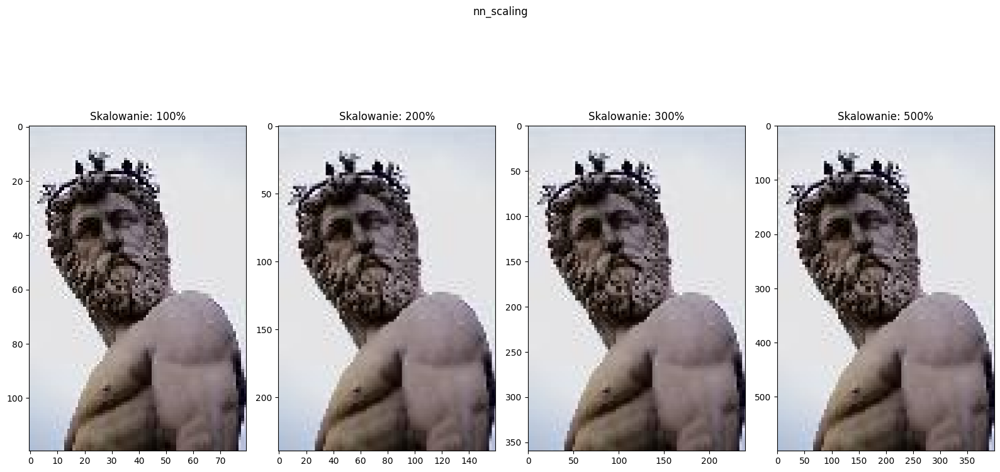

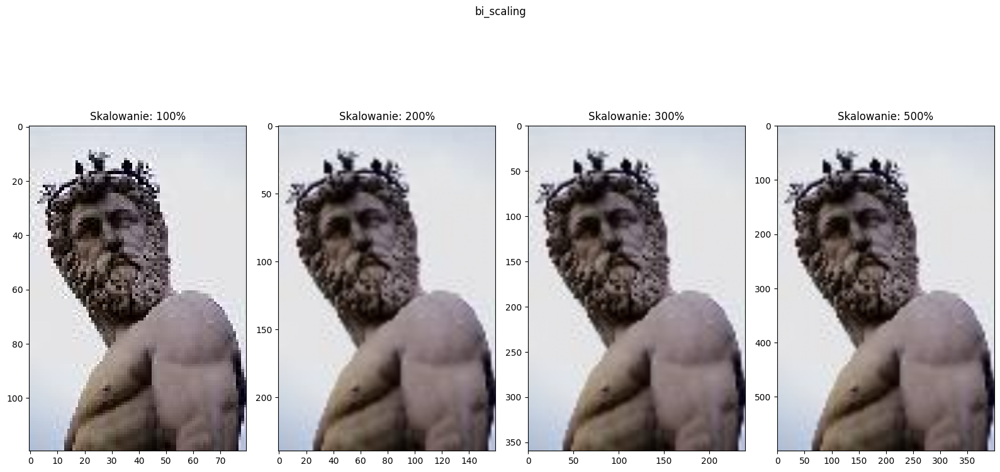

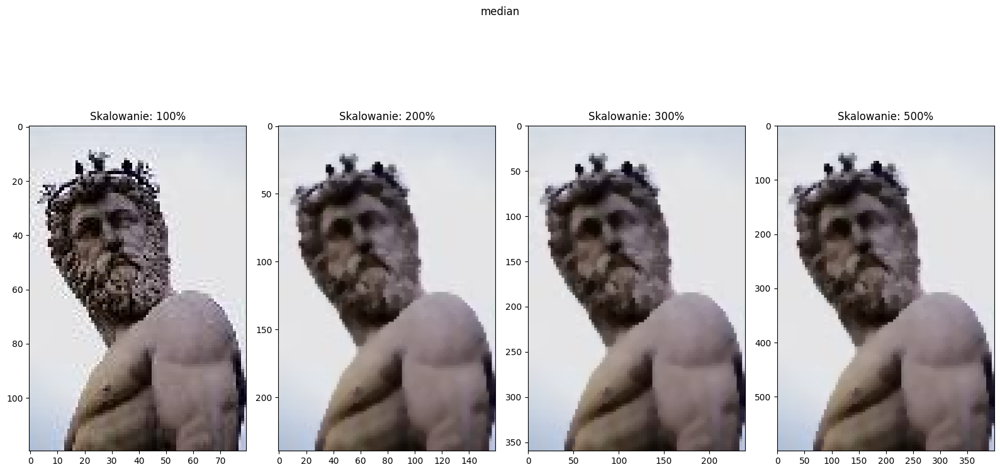

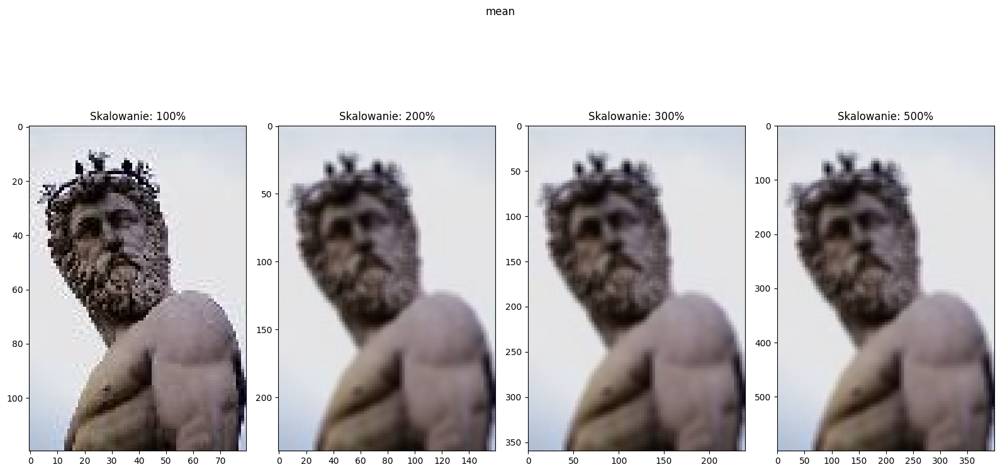

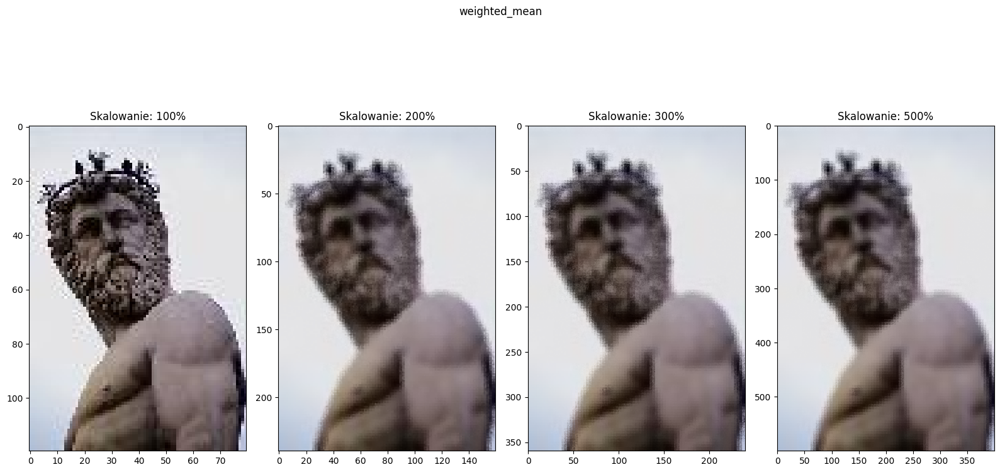

...

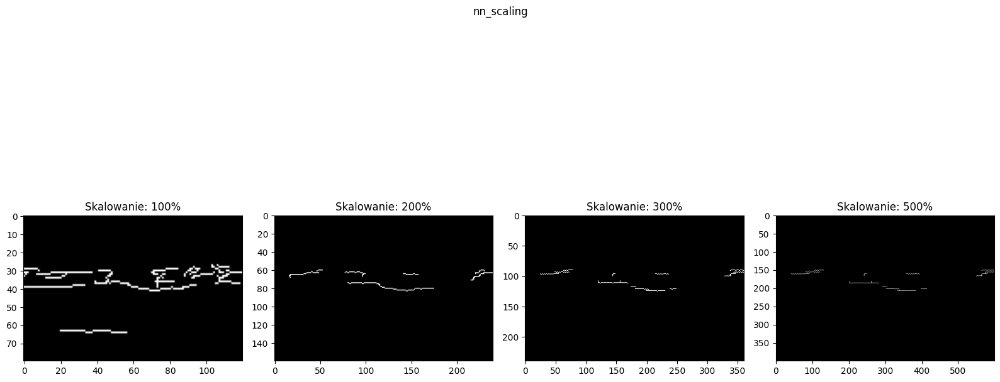

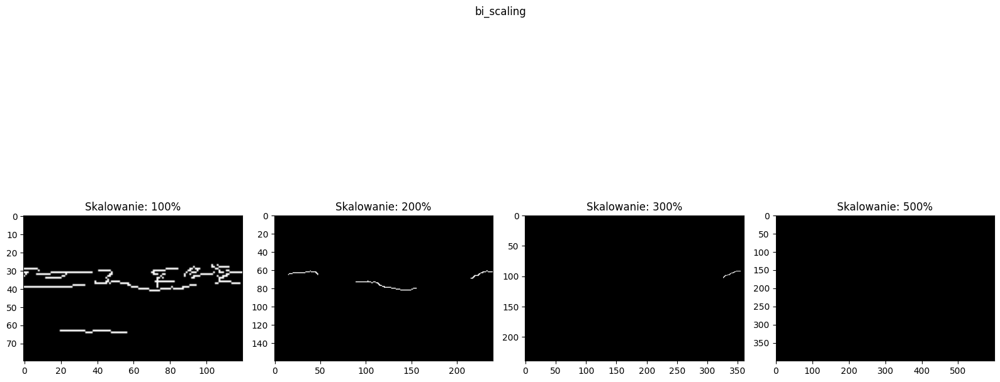

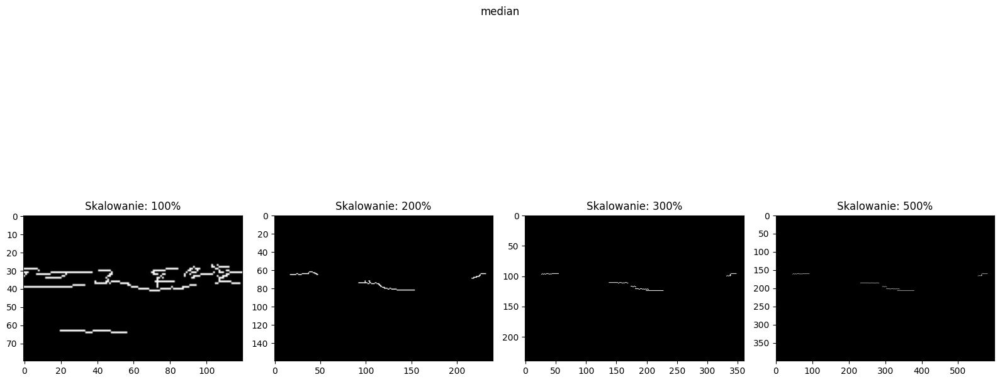

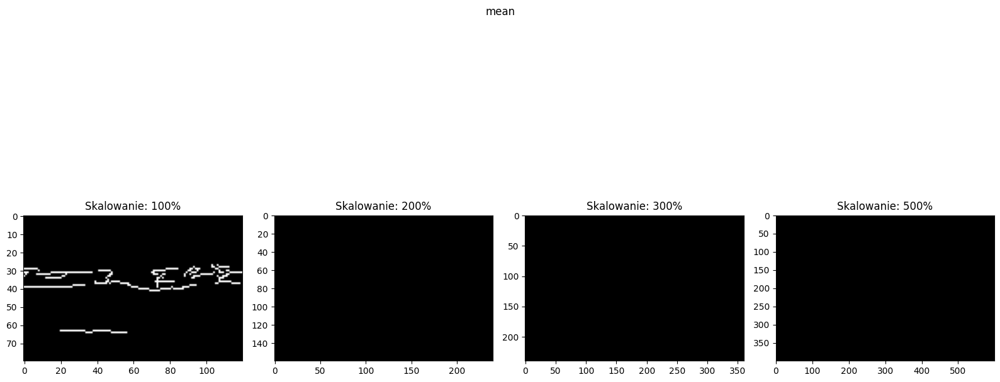

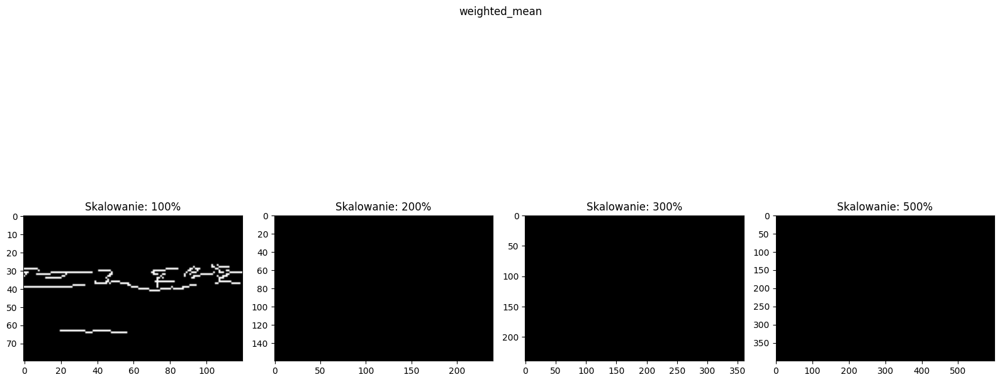

In [ ]:
fig_1x4_nn_bi('/content/SMALL_0005.jpg')
fig_1x4_nn_bi('/content/SMALL_0005.jpg', algorithm=bi_scaling)
fig_1x4_reduce('/content/SMALL_0005.jpg', method='median')
fig_1x4_reduce('/content/SMALL_0005.jpg', method='mean')
fig_1x4_reduce('/content/SMALL_0005.jpg', method='weighted_mean')

fig_1x4_nn_bi_canny('/content/SMALL_0005.jpg')
fig_1x4_nn_bi_canny('/content/SMALL_0005.jpg', algorithm=bi_scaling)
fig_1x4_reduce_canny('/content/SMALL_0005.jpg', method='median')
fig_1x4_reduce_canny('/content/SMALL_0005.jpg', method='mean')
fig_1x4_reduce_canny('/content/SMALL_0005.jpg', method='weighted_mean')


fig_1x4_nn_bi('/content/SMALL_0006.jpg')
fig_1x4_nn_bi('/content/SMALL_0006.jpg', algorithm=bi_scaling)
fig_1x4_reduce('/content/SMALL_0006.jpg', method='median')
fig_1x4_reduce('/content/SMALL_0006.jpg', method='mean')
fig_1x4_reduce('/content/SMALL_0006.jpg', method='weighted_mean')

fig_1x4_nn_bi_canny('/content/SMALL_0006.jpg')
fig_1x4_nn_bi_canny('/content/SMALL_0006.jpg', algorithm=bi_scaling)
fig_1x4_reduce_canny('/content/SMALL_0006.jpg', method='median')
fig_1x4_reduce_canny('/content/SMALL_0006.jpg', method='mean')
fig_1x4_reduce_canny('/content/SMALL_0006.jpg', method='weighted_mean')

fig_1x4_nn_bi('/content/SMALL_0007.jpg')
fig_1x4_nn_bi('/content/SMALL_0007.jpg', algorithm=bi_scaling)
fig_1x4_reduce('/content/SMALL_0007.jpg', method='median')
fig_1x4_reduce('/content/SMALL_0007.jpg', method='mean')
fig_1x4_reduce('/content/SMALL_0007.jpg', method='weighted_mean')

fig_1x4_nn_bi_canny('/content/SMALL_0007.jpg')
fig_1x4_nn_bi_canny('/content/SMALL_0007.jpg', algorithm=bi_scaling)
fig_1x4_reduce_canny('/content/SMALL_0007.jpg', method='median')
fig_1x4_reduce_canny('/content/SMALL_0007.jpg', method='mean')
fig_1x4_reduce_canny('/content/SMALL_0007.jpg', method='weighted_mean')

fig_1x4_nn_bi('/content/SMALL_0004.jpg')
fig_1x4_nn_bi('/content/SMALL_0004.jpg', algorithm=bi_scaling)
fig_1x4_reduce('/content/SMALL_0004.jpg', method='median')
fig_1x4_reduce('/content/SMALL_0004.jpg', method='mean')
fig_1x4_reduce('/content/SMALL_0004.jpg', method='weighted_mean')

fig_1x4_nn_bi_canny('/content/SMALL_0004.jpg')
fig_1x4_nn_bi_canny('/content/SMALL_0004.jpg', algorithm=bi_scaling)
fig_1x4_reduce_canny('/content/SMALL_0004.jpg', method='median')
fig_1x4_reduce_canny('/content/SMALL_0004.jpg', method='mean')
fig_1x4_reduce_canny('/content/SMALL_0004.jpg', method='weighted_mean')

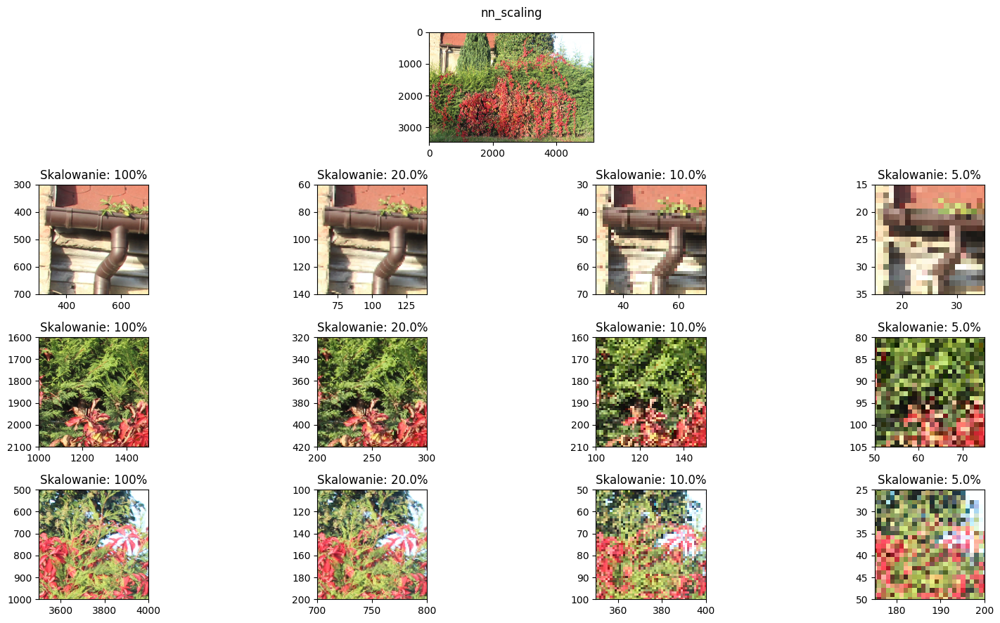

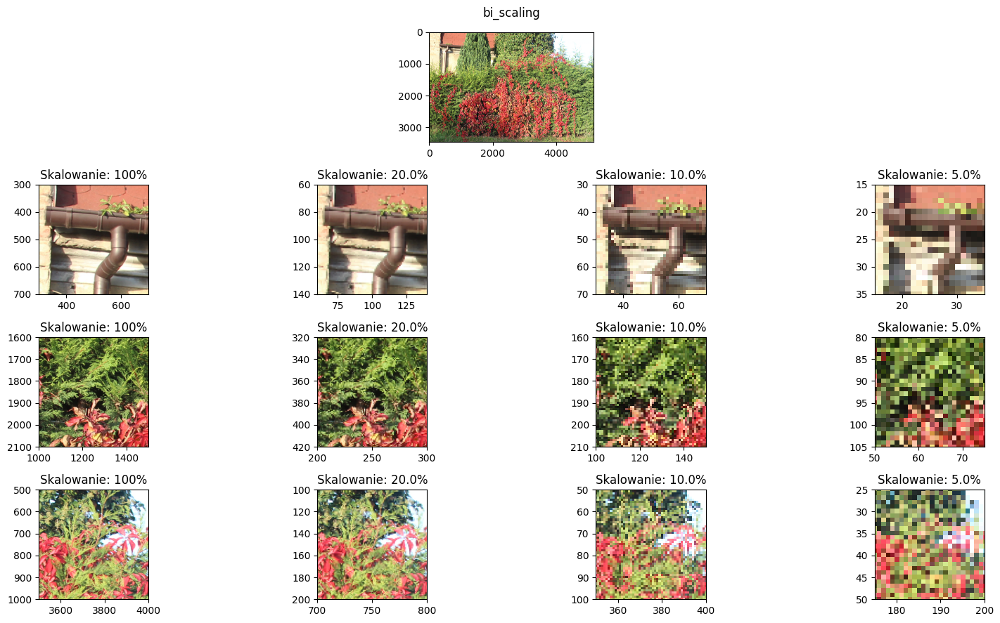

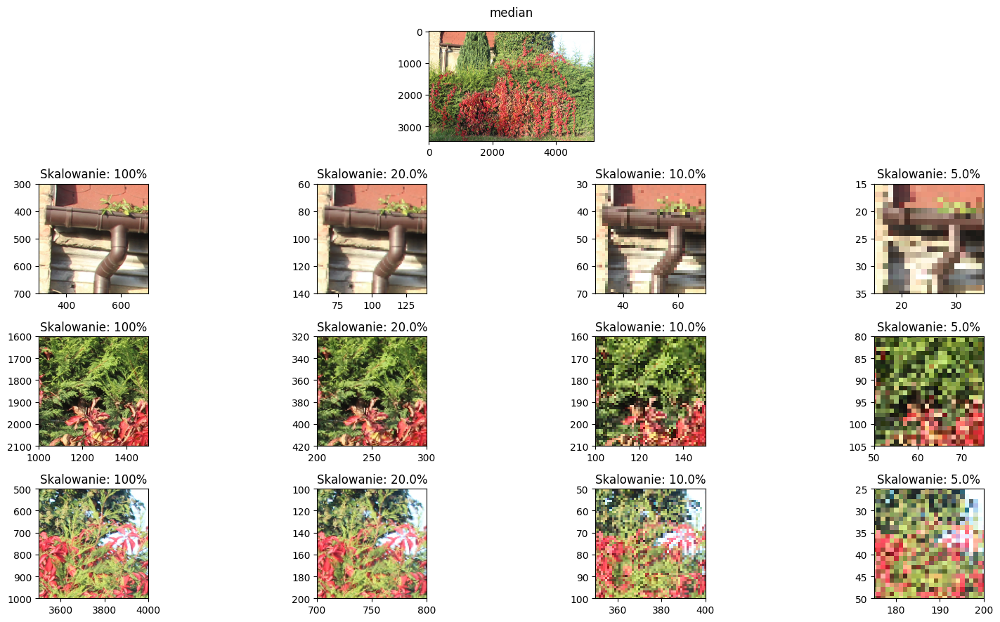

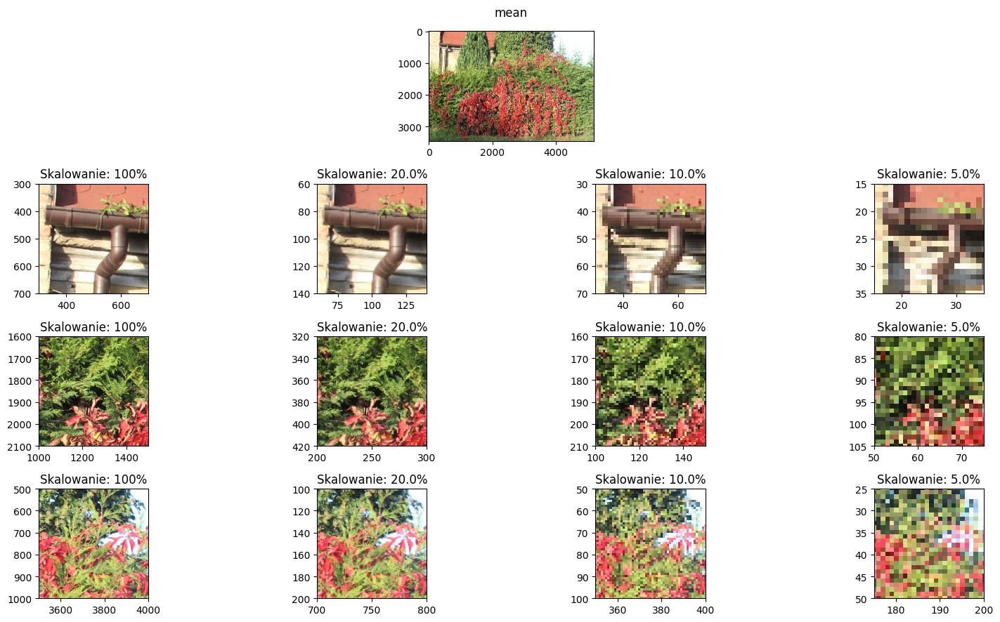

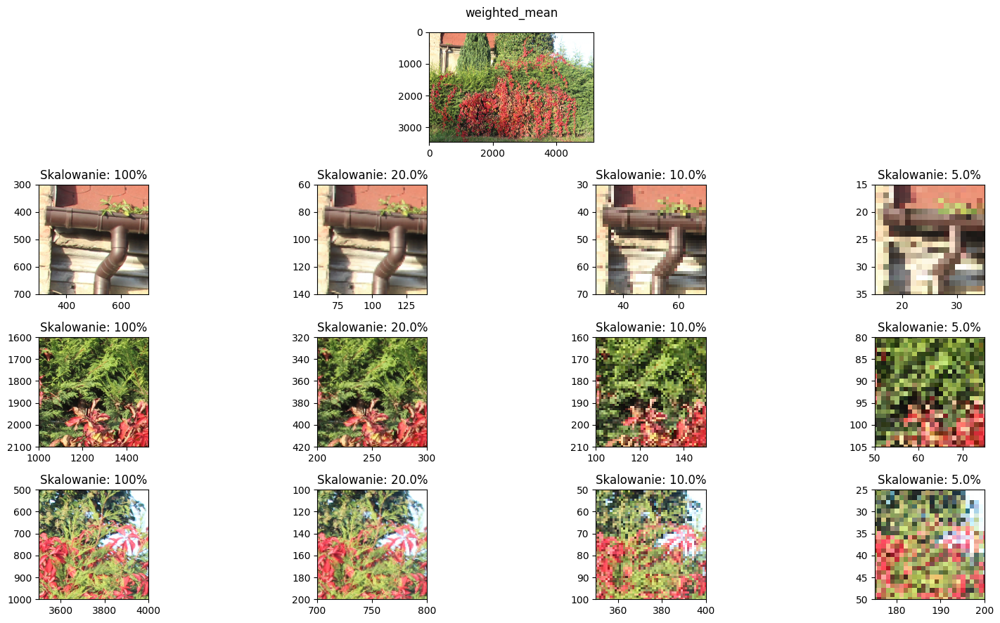

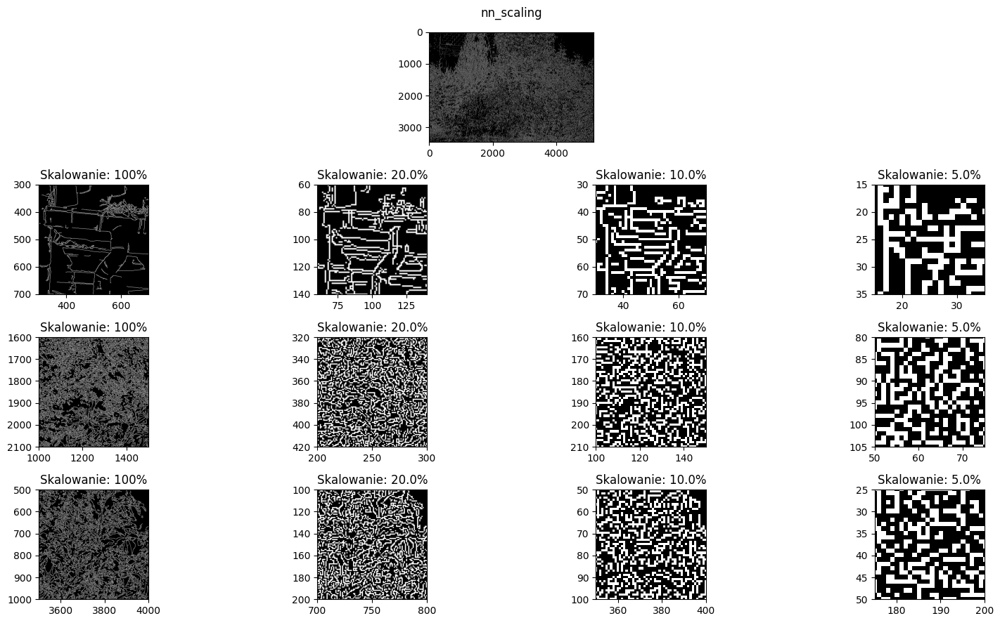

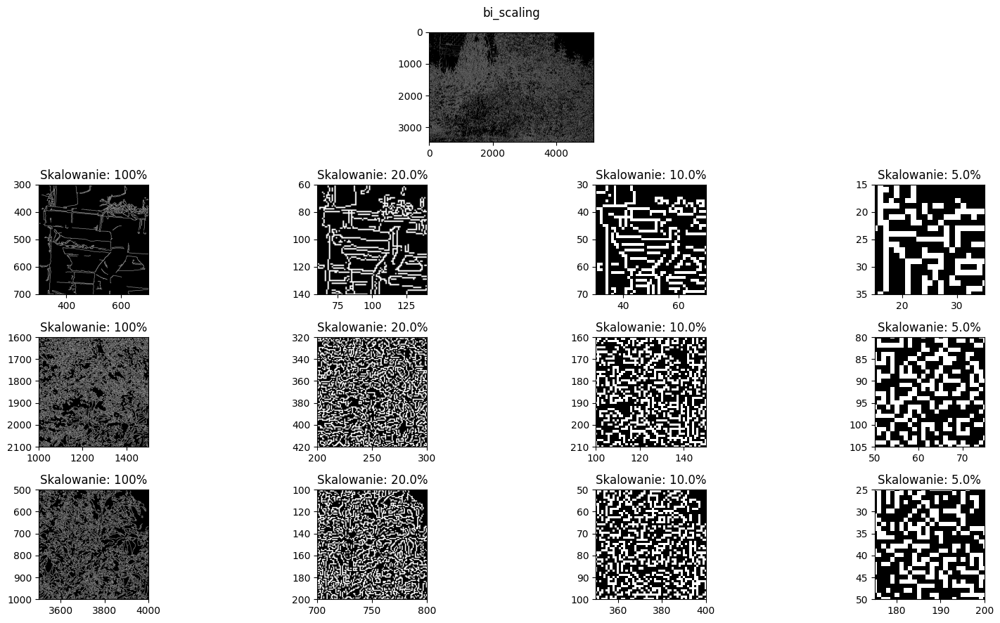

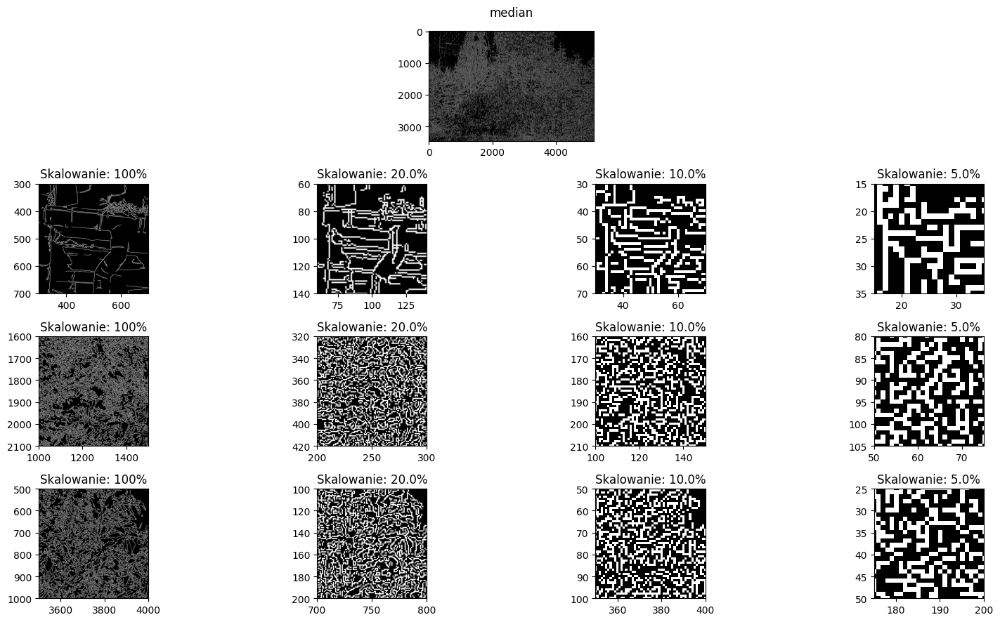

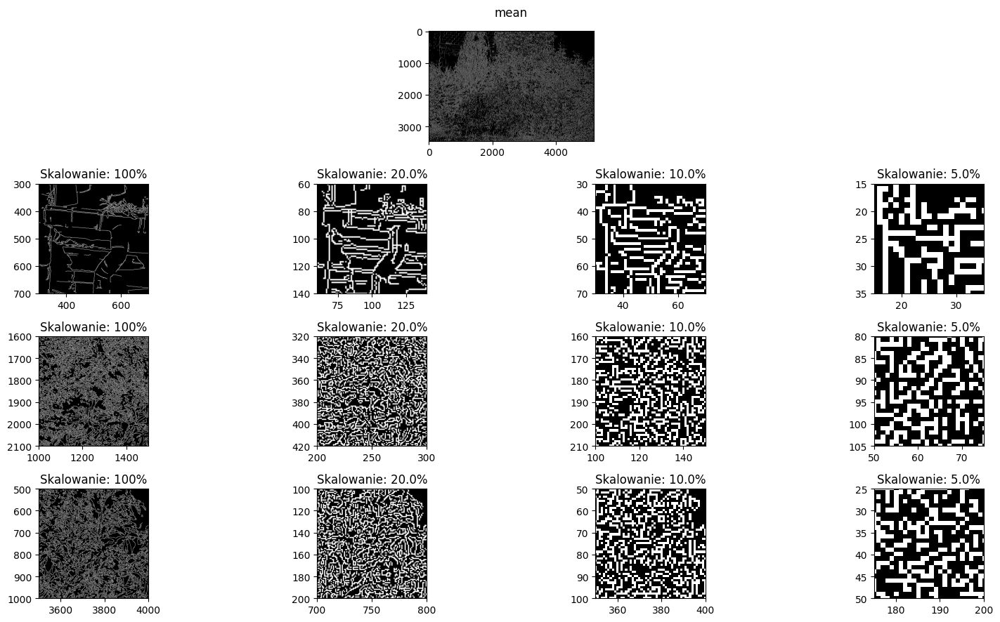

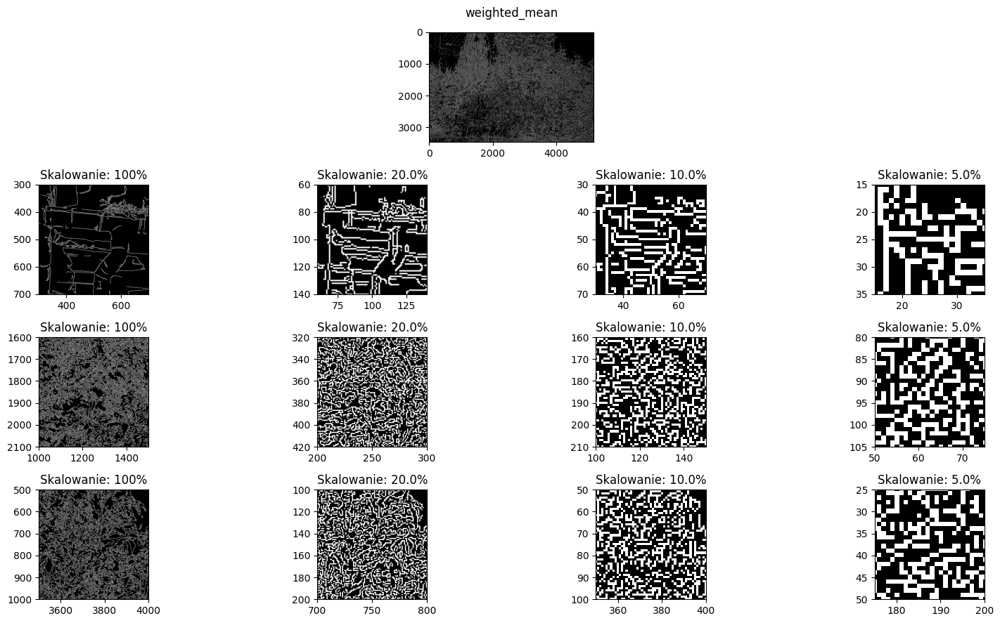

In [ ]:
fig_4x4_nn_bi('/content/BIG_0001.jpg')
fig_4x4_nn_bi('/content/BIG_0001.jpg', algorithm=bi_scaling)
fig_4x4_reduce('/content/BIG_0001.jpg', method='median')
fig_4x4_reduce('/content/BIG_0001.jpg', method='mean')
fig_4x4_reduce('/content/BIG_0001.jpg', method='weighted_mean')

fig_4x4_nn_bi_canny('/content/BIG_0001.jpg')
fig_4x4_nn_bi_canny('/content/BIG_0001.jpg', algorithm=bi_scaling)
fig_4x4_reduce_canny('/content/BIG_0001.jpg', method='median')
fig_4x4_reduce_canny('/content/BIG_0001.jpg', method='mean')
fig_4x4_reduce_canny('/content/BIG_0001.jpg', method='weighted_mean')

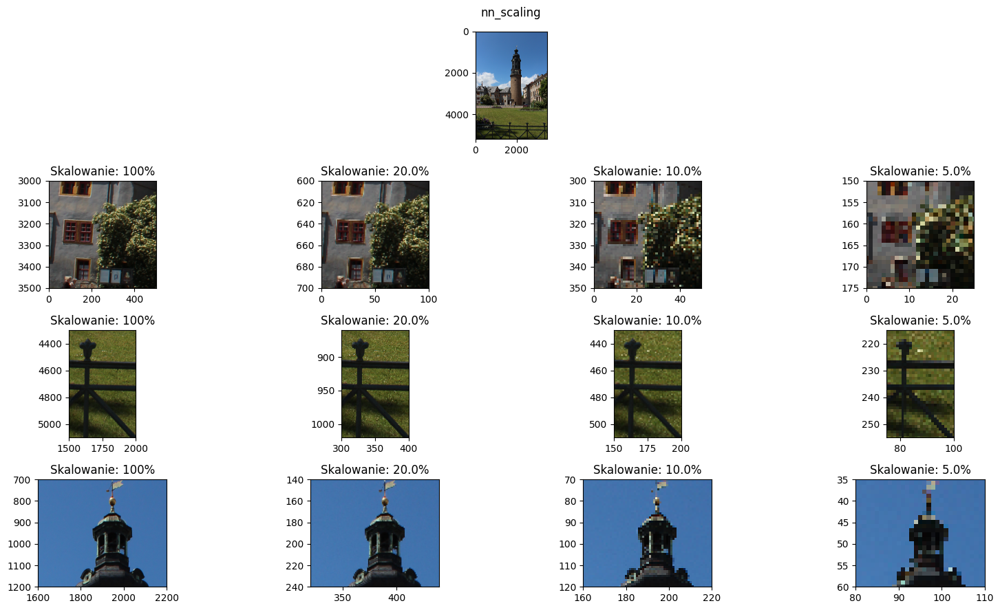

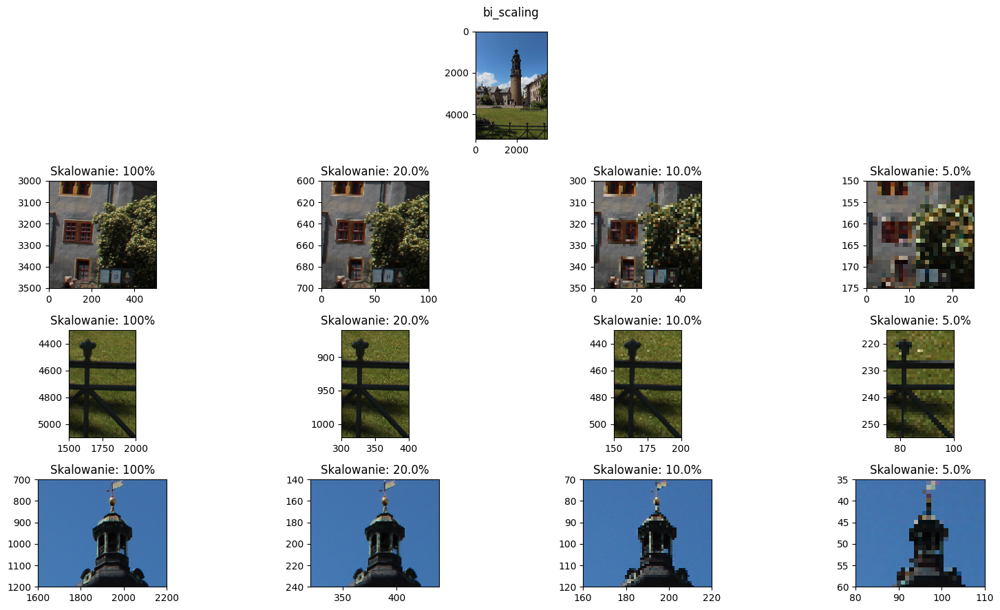

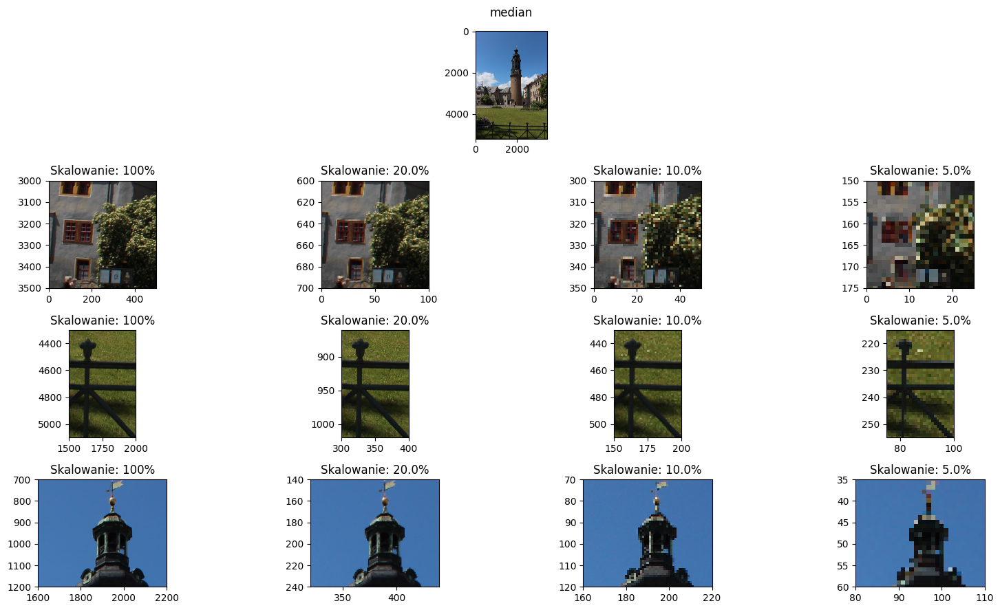

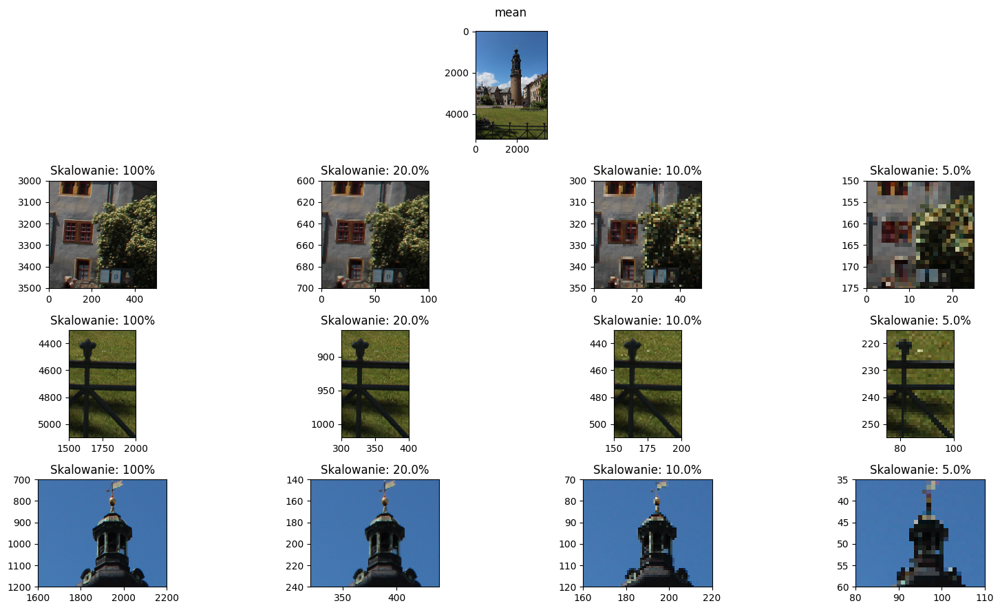

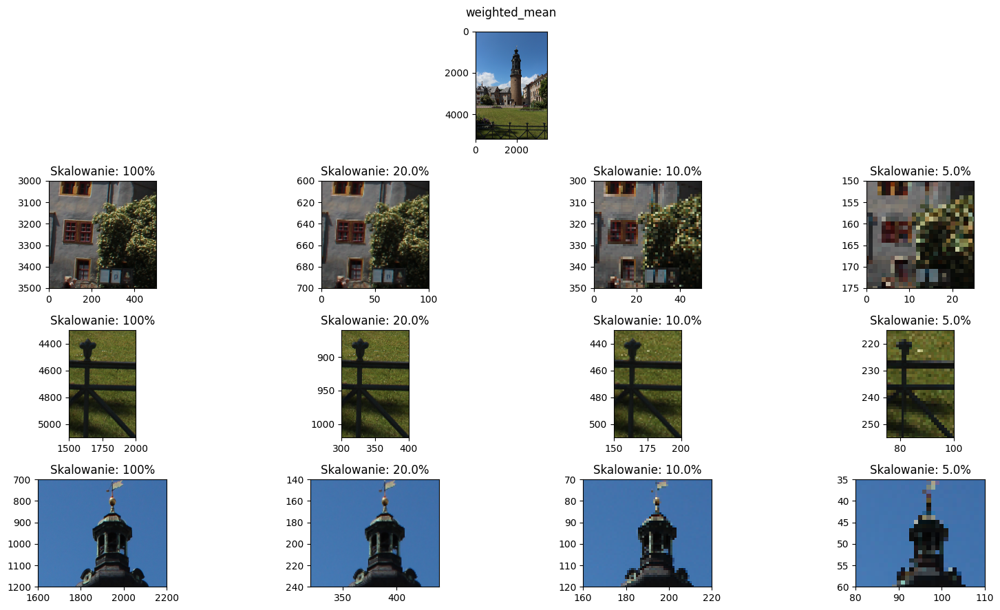

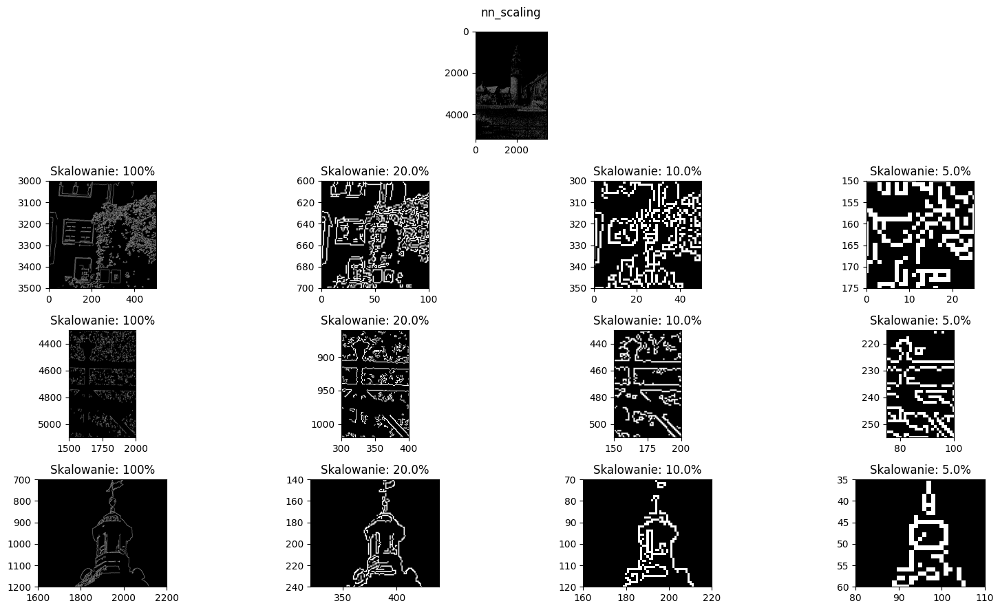

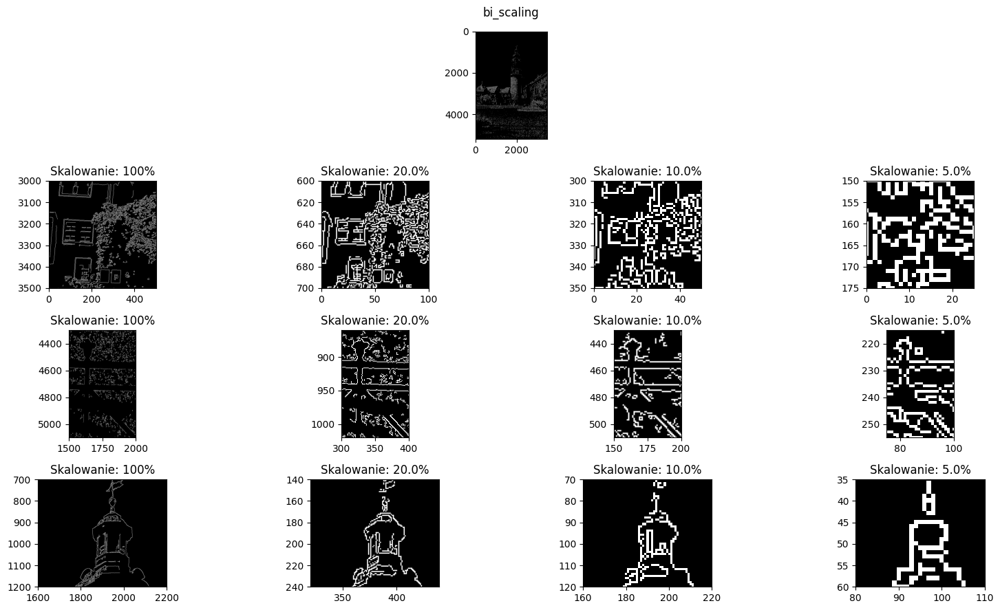

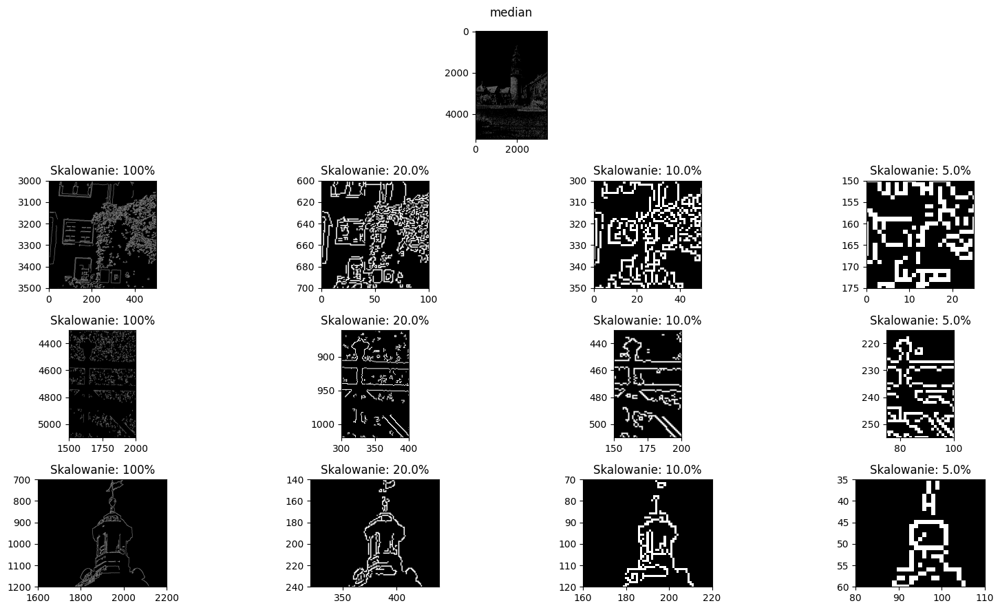

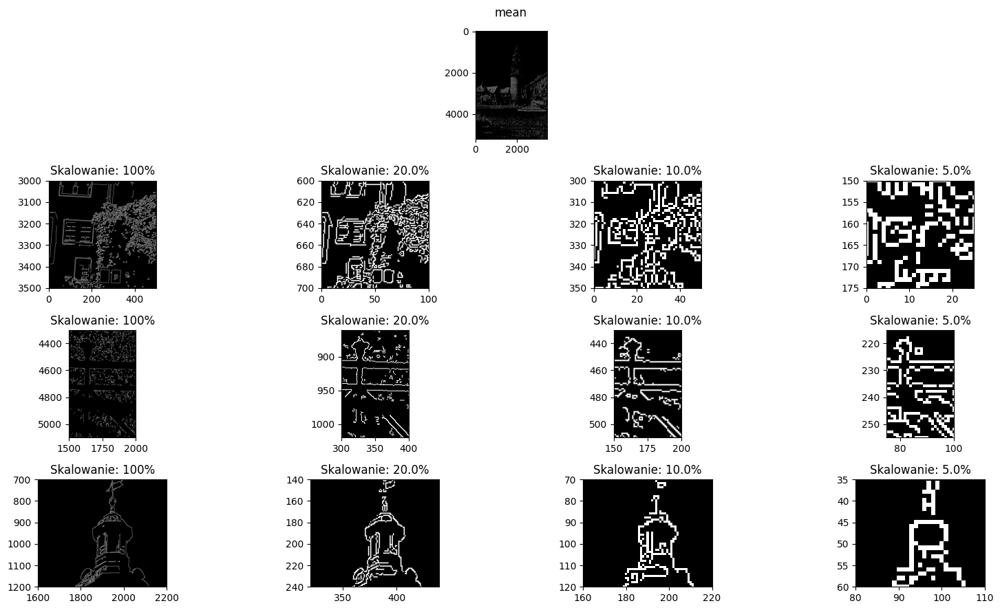

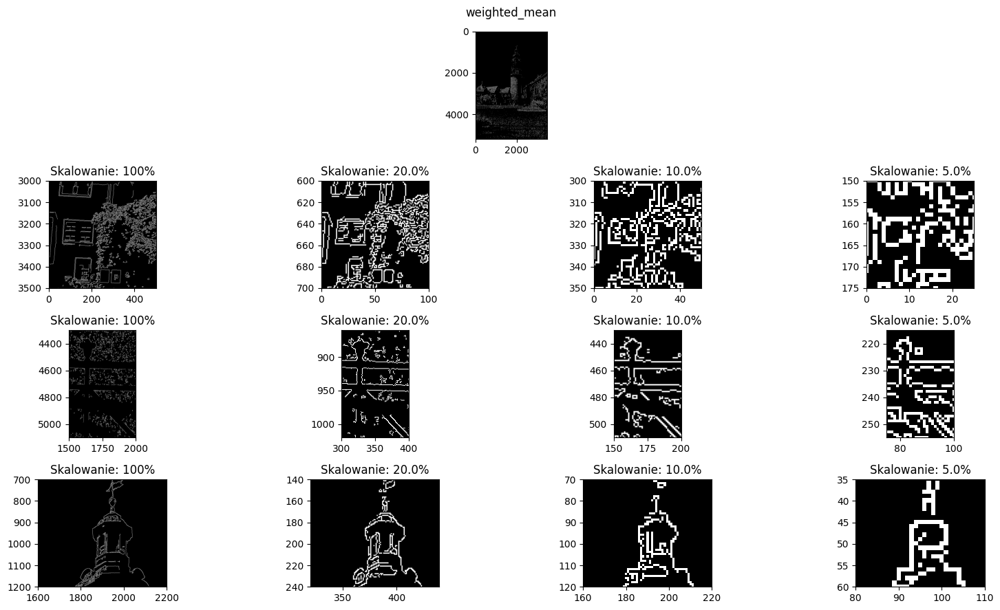

In [ ]:
fragments=[[(0,500),(3500, 3000)],[(1500, 2000),(5100, 4300)], [(1600,2200),(1200, 700)]]

fig_4x4_nn_bi('/content/BIG_0003.jpg', fragments=fragments)
fig_4x4_nn_bi('/content/BIG_0003.jpg', algorithm=bi_scaling, fragments=fragments)
fig_4x4_reduce('/content/BIG_0003.jpg', method='median', fragments=fragments)
fig_4x4_reduce('/content/BIG_0003.jpg', method='mean', fragments=fragments)
fig_4x4_reduce('/content/BIG_0003.jpg', method='weighted_mean', fragments=fragments)

fig_4x4_nn_bi_canny('/content/BIG_0003.jpg', fragments=fragments)
fig_4x4_nn_bi_canny('/content/BIG_0003.jpg', algorithm=bi_scaling, fragments=fragments)
fig_4x4_reduce_canny('/content/BIG_0003.jpg', method='median', fragments=fragments)
fig_4x4_reduce_canny('/content/BIG_0003.jpg', method='mean', fragments=fragments)
fig_4x4_reduce_canny('/content/BIG_0003.jpg', method='weighted_mean', fragments=fragments)

In [ ]:
fragments=[[(0,500),(3500, 3000)],[(1500, 2000),(5100, 4300)], [(1600,2200),(1200, 700)]]
multipliers = [1, 2, 3, 5]

fig_4x4_nn_bi('/content/BIG_0003.jpg', fragments=fragments)
fig_4x4_nn_bi('/content/BIG_0003.jpg', algorithm=bi_scaling, fragments=fragments)
fig_4x4_reduce('/content/BIG_0003.jpg', method='median', fragments=fragments)
fig_4x4_reduce('/content/BIG_0003.jpg', method='mean', fragments=fragments)
fig_4x4_reduce('/content/BIG_0003.jpg', method='weighted_mean', fragments=fragments)

fig_4x4_nn_bi_canny('/content/BIG_0003.jpg', fragments=fragments)
fig_4x4_nn_bi_canny('/content/BIG_0003.jpg', algorithm=bi_scaling, fragments=fragments)
fig_4x4_reduce_canny('/content/BIG_0003.jpg', method='median', fragments=fragments)
fig_4x4_reduce_canny('/content/BIG_0003.jpg', method='mean', fragments=fragments)
fig_4x4_reduce_canny('/content/BIG_0003.jpg', method='weighted_mean', fragments=fragments)

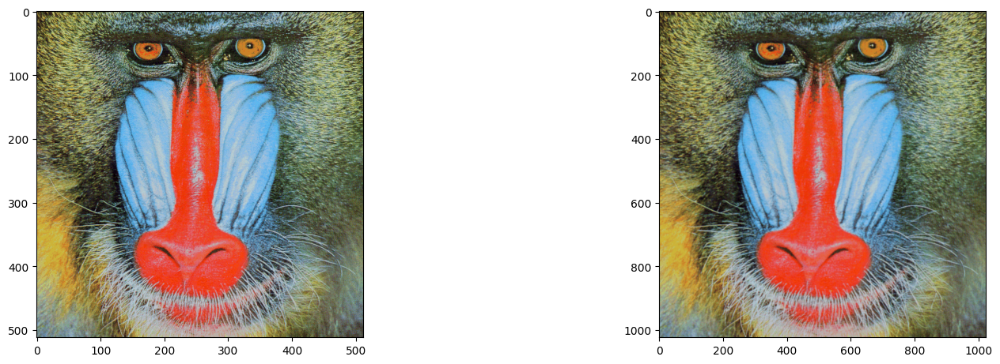

In [ ]:
#biinterp

img1 = plt.imread('/content/SMALL_0001.tif')

img1_scaled = bi_scaling(img1, 2)
plt.figure(figsize=(16,9))
plt.subplot(2,2,1)
plt.imshow(img1)
plt.subplot(2,2,2)
plt.tight_layout()
plt.imshow(img1_scaled)

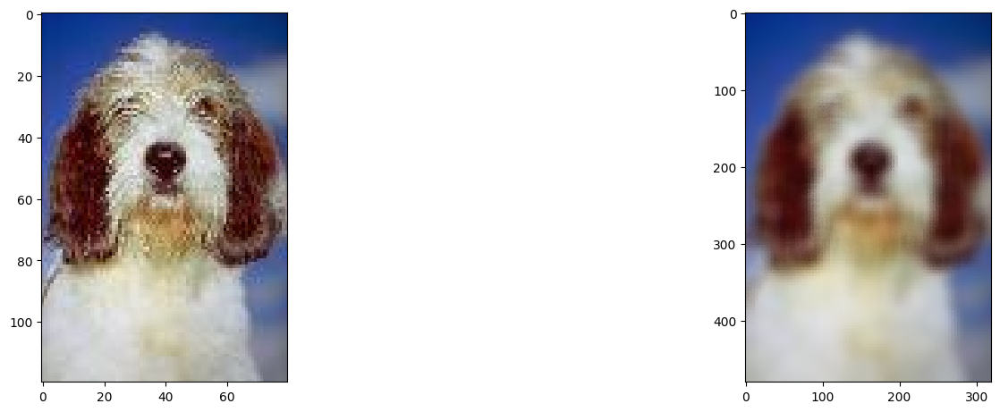

In [ ]:
#średnie, mediany etc.

img1 = plt.imread('/content/SMALL_0007.jpg')

img1_scaled = reduce_image(img1, 4, 'weighted mean', 5)
plt.figure(figsize=(16,9))
plt.subplot(2,2,1)
plt.imshow(img1)
plt.subplot(2,2,2)
plt.tight_layout()
plt.imshow(img1_scaled)
plt.savefig("/content/test.pdf")